# Aug 8, 2025: dummy solution landscape

In [1]:
import csv
import os
import sys
import numpy as np
import pandas as pd
import scipy as sp 
import dill as pickle 
from os.path import join as pjoin
from itertools import product
from tqdm import tqdm
from copy import deepcopy
from pathlib import Path
import subprocess
from scipy import sparse, stats
from multiprocessing import Pool
import glob
# from numba import jit
# import arviz as az
import random

from itertools import product, combinations
import multiprocessing as mp
from functools import partial

from sklearn.cluster import KMeans
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics.pairwise import cosine_similarity
from munkres import Munkres

# networks
import graph_tool.all as gt

# plotting
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cm import rainbow
from cycler import cycler

plt.rcParamsDefault['font.family'] = "sans-serif"
plt.rcParamsDefault['font.sans-serif'] = "Arial"
plt.rcParams['font.size'] = 14
plt.rcParams["errorbar.capsize"] = 0.5

# import cmasher as cmr  # CITE ITS PAPER IN YOUR MANUSCRIPT
import colorcet as cc

# ignore user warnings
import warnings
warnings.filterwarnings("ignore") #, category=UserWarning)

In [2]:
def get_colorblind_palette(n=20):
    """Return a merged, deduplicated colorblind-safe palette from CUD, Seaborn, and extended sources."""
    base = [
        "#0072B2", "#D55E00", "#009E73", "#CC79A7",
        "#F0E442", "#56B4E9", "#E69F00", "#000000",
        "#999999", "#882255", "#44AA99", "#117733"
    ]
    
    new = [
        "#0173B2", "#DE8F05", "#029E73", "#D55E00",  # D55E00 already in base
        "#CC78BC", "#CA9161", "#FBAFE4", "#949494",
        "#ECE133", "#56B4E9"  # 56B4E9 already in base
    ]
    
    # Deduplicate while preserving order
    seen = set()
    full = base + new
    merged = []
    for color in full:
        if color.lower() not in seen:
            merged.append(color)
            seen.add(color.lower())
    
    return merged[:n]

def setup_mpl(fontsize=7):
    """Configure matplotlib for Illustrator export with Helvetica-style fonts and clean styles."""
    
    CUD_COLORS = get_colorblind_palette()
    
    mpl.rcParams.update({
        # Fonts and layout
        "font.family": "sans-serif",
        "font.sans-serif": ["Arial", "DejaVu Sans"],
        "font.size": fontsize,
        "axes.titlesize": fontsize,
        "axes.labelsize": fontsize,
        "xtick.labelsize": fontsize,
        "ytick.labelsize": fontsize,
        "legend.fontsize": fontsize,

        # Export settings
        "svg.fonttype": 'none',
        "pdf.fonttype": 42,
        "ps.fonttype": 42,
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "text.usetex": False,

        # Axes and ticks
        "axes.linewidth": 0.5,
        "xtick.major.width": 0.5,
        "ytick.major.width": 0.5,
        "xtick.minor.width": 0.5,
        "ytick.minor.width": 0.5,
        "xtick.major.size": 2.5,
        "ytick.major.size": 2.5,

        # Lines
        "lines.linewidth": 1.0,

        # Default color cycle (Color Universal Design)
        "axes.prop_cycle": cycler('color', CUD_COLORS),
    })

    # mpl.rcParams["axes.prop_cycle"] = cycler('color', get_colorblind_palette())

In [3]:
setup_mpl(fontsize=7)
CUD_COLORS = get_colorblind_palette()

In [4]:
import seaborn as sns

In [5]:
class ARGS():
    pass

args = ARGS()

args.SEED = 100

In [6]:
args.source = 'allen' #'spatial' #'allen'
args.space = 'ccfv2' #'ccfv2'
args.brain_div = 'whl' #'whl'
args.num_rois = 172 #162 #172
args.resolution = 200 #200

PARC_DESC = (
    f'source-{args.source}'
    f'_space-{args.space}'
    f'_braindiv-{args.brain_div}'
    f'_nrois-{args.num_rois}'
    f'_res-{args.resolution}'
)
PARC_DESC

'source-allen_space-ccfv2_braindiv-whl_nrois-172_res-200'

In [7]:
args.GRAPH_DEF = f'constructed'
args.GRAPH_METHOD = f'pearson'
args.THRESHOLD = f'signed'
args.EDGE_DEF = f'binary'
args.EDGE_DENSITY = 20
args.LAYER_DEF = f'individual'
args.DATA_UNIT = f'sub'

BASE_path = f'{os.environ["HOME"]}/new_mouse_dataset'
PARCELS_path = f'{BASE_path}/parcels'
ROI_path = (
    f'{BASE_path}/roi-results-v3'
    f'/{PARC_DESC}_desc-ts-concat'
)
TS_path = f'{ROI_path}/roi_timeseries'
ROI_RESULTS_path = (
    f'{ROI_path}'
    f'/graph-{args.GRAPH_DEF}/method-{args.GRAPH_METHOD}'
    f'/threshold-{args.THRESHOLD}/edge-{args.EDGE_DEF}/density-{args.EDGE_DENSITY}'
    f'/layer-{args.LAYER_DEF}/unit-{args.DATA_UNIT}'
)
GRAPH_path = f'{ROI_RESULTS_path}/graphs'
os.system(f'mkdir -p {GRAPH_path}')
SBM_path = f'{ROI_RESULTS_path}/model-fits'
os.system(f'mkdir -p {SBM_path}')
DIAG_path = f'{ROI_RESULTS_path}/diagnostics'
os.system(f'mkdir -p {DIAG_path}')
ESTIM_path = f'{ROI_RESULTS_path}/estimates'
os.system(f'mkdir -p {ESTIM_path}/individual')
os.system(f'mkdir -p {ESTIM_path}/group')

0

In [8]:
args.dc, args.sbm = False, 'd'
args.nested = args.sbm == 'h'

args.force_niter = 40000
args.num_draws = int((1/2) * args.force_niter)

args.epsilon = 0.4 # threshold KSD for convergence
args.delta = np.ceil(args.force_niter / 100).astype(int)

def sbm_name(args):
    dc = f'dc' if args.dc else f'nd'
    dc = f'' if args.sbm in ['a', 'm'] else dc
    file = f'sbm-{dc}-{args.sbm}'
    return file

SBM = sbm_name(args)
SBM

'sbm-nd-d'

In [9]:
gfile = sorted(glob.glob(f'{GRAPH_path}/*', recursive=True))[0]
g = gt.load_graph(gfile)
g

<Graph object, undirected, with 172 vertices and 2942 edges, 1 internal edge property, at 0x7fbfc66106e0>

In [10]:
sub = 'SLC09' # 05, 06, 07
indiv_files = sorted(glob.glob(f'{ESTIM_path}/individual/sub-{sub}/partition-modes-group-aligned/{SBM}/desc-modes.pkl'))
indiv_file = indiv_files[0]

with open(indiv_file, 'rb') as f:
    df = pickle.load(f)

In [11]:
df

,sub,sbm,mode_aligned,omega
25,SLC09,sbm-nd-d,<graph_tool.inference.partition_modes.Partitio...,0.244361
26,SLC09,sbm-nd-d,<graph_tool.inference.partition_modes.Partitio...,0.237722
27,SLC09,sbm-nd-d,<graph_tool.inference.partition_modes.Partitio...,0.184610
28,SLC09,sbm-nd-d,<graph_tool.inference.partition_modes.Partitio...,0.170373
29,SLC09,sbm-nd-d,<graph_tool.inference.partition_modes.Partitio...,0.162854
30,SLC09,sbm-nd-d,<graph_tool.inference.partition_modes.Partitio...,0.000080


In [12]:
sigmas = []
for idx, row in df.iterrows():
    mode = row['mode_aligned']
    sigmas += [mode.posterior_cdev()]
    
sigmas

[0.05275447960350743,
 0.08269005276529284,
 0.0762099308610944,
 0.10728454172366608,
 0.06734198887145137,
 0.0]

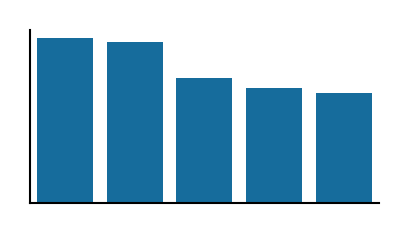

In [21]:
fig, ax = plt.subplots(1,1, figsize=(1.5, 0.75), dpi=300)
sns.barplot(df['omega'].values[:-1], width=0.8, ax=ax)
ax.set(yticks=[], xticks=[])
sns.despine(ax=ax)

In [ ]:
bs = []
for idx, row in df.iterrows():
    mode = row['mode_aligned']
    bs += [np.array(list(b)) for b in mode.get_partitions().values()]
len(bs)

1001

In [ ]:
from scipy.stats import entropy

def variation_of_information(x, y):
    """
    Compute the Variation of Information (VI) between two partitions.
    Parameters:
        x, y: 1D integer arrays (same length)
    Returns:
        vi: float
    """
    x = np.asarray(x)
    y = np.asarray(y)
    assert x.shape == y.shape

    n = len(x)
    x_labels, x_ids = np.unique(x, return_inverse=True)
    y_labels, y_ids = np.unique(y, return_inverse=True)

    # Contingency table
    contingency = np.zeros((len(x_labels), len(y_labels)), dtype=np.int32)
    np.add.at(contingency, (x_ids, y_ids), 1)

    pij = contingency / n
    pi = pij.sum(axis=1, keepdims=True)  # shape (R, 1)
    pj = pij.sum(axis=0, keepdims=True)  # shape (1, S)

    # Mask for nonzero joint probabilities
    nz = pij > 0

    mi = np.sum(pij[nz] * np.log(pij[nz] / (pi @ pj)[nz]))
    h_x = entropy(pi.ravel())
    h_y = entropy(pj.ravel())

    return h_x + h_y - 2 * mi

def compute_distance_matrix(partitions, metric_fn):
    """
    Compute a symmetric pairwise distance matrix from a list of partitions.
    Parameters:
        partitions: list of 1D arrays
        metric_fn: function like variation_of_information or reduced_mutual_information
    Returns:
        dist_matrix: 2D numpy array
    """
    M = len(partitions)
    dist = np.zeros((M, M))
    for i in tqdm(range(M)):
        for j in range(i + 1, M):
            d = metric_fn(partitions[i], partitions[j])
            dist[i, j] = dist[j, i] = d
    return dist

In [ ]:
vi_matrix = compute_distance_matrix(bs, variation_of_information)
vi_matrix.shape

100%|██████████| 1001/1001 [04:42<00:00,  3.55it/s]


(1001, 1001)

<Axes: >

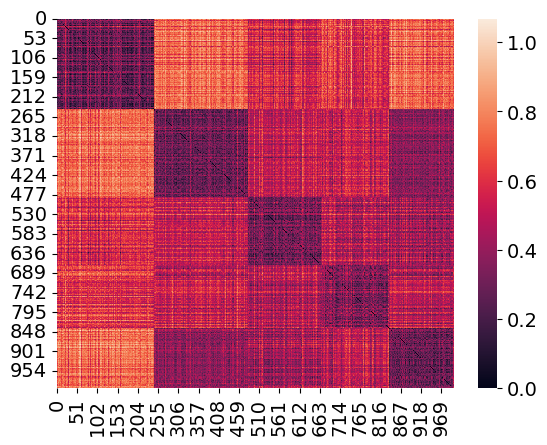

In [ ]:
sns.heatmap(vi_matrix)

In [ ]:
from umap import UMAP 

reducer = UMAP(metric='precomputed', n_neighbors=10, min_dist=0.1, random_state=args.SEED)
embedding = reducer.fit_transform(vi_matrix)
embedding

array([[-1.8675506,  2.8113184],
       [-3.835251 ,  4.2235   ],
       [-3.9950154,  3.7581244],
       ...,
       [ 8.1985655,  2.9169405],
       [ 7.8332686,  3.6662273],
       [ 9.859624 , -1.7773443]], dtype=float32)

In [ ]:
from scipy.stats import gaussian_kde
from mpl_toolkits.mplot3d import Axes3D  # enables 3D plotting

# Assume embedding is (M, 2)
x, y = embedding[:, 0], embedding[:, 1]

# Step 1: Fit KDE in 2D
xy = np.vstack([x, y])
kde = gaussian_kde(xy, bw_method='scott')  # or adjust bandwidth

# Step 2: Evaluate KDE on grid
x_min, x_max = x.min() - 3.0, x.max() + 3.0
y_min, y_max = y.min() - 3.0, y.max() + 3.0
x_grid, y_grid = np.mgrid[x_min:x_max:500j, y_min:y_max:500j]
grid_coords = np.vstack([x_grid.ravel(), y_grid.ravel()])
z = kde(grid_coords).reshape(x_grid.shape)

In [ ]:
import plotly.graph_objects as go

vert_exag = 2.0
z_plot = ((z - z.min()) / (z.max() - z.min() + 1e-12)) ** 0.8 * vert_exag

fig = go.Figure(go.Surface(
    x=x_grid, y=y_grid, z=z_plot,
    colorscale='Blues',
    showscale=False,
    lighting=dict(ambient=1.0, diffuse=0.0, specular=0.0, roughness=1.0, fresnel=0.0)  # flat, no glints
))
fig.update_layout(
    width=900, height=700,
    scene=dict(
        xaxis=dict(visible=False), yaxis=dict(visible=False), zaxis=dict(visible=False),
        aspectratio=dict(x=1, y=1, z=vert_exag/4),  # tweak z feel independent of data scale
        bgcolor='white',
        camera=dict(eye=dict(x=1.6, y=1.6, z=1.2))
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)
fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go

S, T = 12, 500
t = np.linspace(0, 10, T)
X = np.sin(2*np.pi*(0.01*t)[None, :] + np.linspace(0, 2*np.pi, S)[:, None]) \
    + 0.5*np.random.randn(S, T)

# optional per-row standardization (keeps amplitudes comparable)
Xz = (X - X.mean(axis=1, keepdims=True)) / (X.std(axis=1, keepdims=True) + 1e-12)

offset = 2.2   # vertical spacing between rows
fig = go.Figure()

for i in range(S):
    y = Xz[i] + i*offset
    fig.add_trace(go.Scatter(
        x=t, y=y, mode="lines",
        line=dict(width=1.2),
        name=f"s{i+1}",
        showlegend=False
    ))
    # thin baseline
    fig.add_shape(type="line",
        x0=t[0], x1=t[-1], y0=i*offset, y1=i*offset,
        line=dict(width=0.6, color="rgba(0,0,0,0.25)")
    )

fig.update_layout(
    width=900, height=500,
    xaxis_title="time (s)",
    yaxis=dict(
        tickmode="array",
        tickvals=[i*offset for i in range(S)],
        ticktext=[f"s{i+1}" for i in range(S)],
        showgrid=False, zeroline=False
    ),
    template="simple_white",
    margin=dict(l=70, r=20, t=20, b=50)
)
fig.show()
